<a href="https://colab.research.google.com/github/neehasajja/waymo-opendataset/blob/main/types_of_objects.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pyarrow.parquet as pq
import pandas as pd

# Set the path to the Parquet file
parquet_file_path = '/content/drive/MyDrive/validation/camera_image/file2.parquet'

# Read the Parquet file into a Pyarrow table
table = pq.read_table(parquet_file_path)

# Convert the table to a Pandas DataFrame
df = table.to_pandas()

# Print the first 10 rows of the DataFrame
print(df.head(10))
print(df['[CameraImageComponent].image'])

                                                               key.segment_context_name  \
index                                                                                     
17065833287841703_2980_000_3000_000;15536288642...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288642...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288642...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288642...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288642...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288643...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288643...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288643...  17065833287841703_2980_000_3000_000   
17065833287841703_2980_000_3000_000;15536288643...  17065833287841703_2980_000_3000_000   

In [10]:
import pyarrow.parquet as pq
import pandas as pd

# Set the path to the Parquet file
parquet_file_path = '/content/drive/MyDrive/validation/stats/file1.parquet'

# Read the Parquet file into a Pyarrow table
table = pq.read_table(parquet_file_path)

# Convert the table to a Pandas DataFrame
df = table.to_pandas()

# Print the first 10 rows of the DataFrame
print(df.head(10))
print(df.columns)

                                                               key.segment_context_name  \
index                                                                                     
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450727...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450728...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450729...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450730...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450731...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450732...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450733...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450734...  30779396576054160_1880_000_1900_000   

In [12]:
import pyarrow.parquet as pq
import io
from PIL import Image, ImageDraw
import pandas as pd

# Path to the Parquet files
stats_file_path = '/content/drive/MyDrive/validation/stats/file1.parquet'
image_file_path = '/content/drive/MyDrive/validation/camera_image/file1.parquet'

# Read the Parquet files using pyarrow
stats_data = pq.read_table(stats_file_path).to_pandas()
image_data = pq.read_table(image_file_path).to_pandas()

# Object mapping dictionary
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}
# Set the desired frame timestamp and camera name
frame_timestamp = 1557845092364266
camera_name = 3

# Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.segment_context_name'] == camera_name)]

# Print the df_box_frame for debugging
print(df_box_frame)

# Check if there are any matching rows
if len(df_box_frame) > 0:
    # Get the corresponding image row based on frame timestamp
    image_row = image_data[image_data['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract objects information from the camera object counts column
    objects_in_image = df_box_frame['[StatsComponent].camera_object_counts.types'].values[0]

    # Convert object IDs to labels using the mapping
    labels = [object_mapping[obj_id] for obj_id in objects_in_image]
    print("Objects in Image:", labels)

    # Load and process the image
    image_bytes = image_row['[CameraImageComponent].image'].values[0]
    image_stream = io.BytesIO(image_bytes)
    img = Image.open(image_stream)
    draw = ImageDraw.Draw(img)

    # Get the bounding box coordinates
    x1 = int(df_box_frame['[CameraBoxComponent].box.center.x'].values[0] - df_box_frame['[CameraBoxComponent].box.size.x'].values[0] / 2)
    y1 = int(df_box_frame['[CameraBoxComponent].box.center.y'].values[0] - df_box_frame['[CameraBoxComponent].box.size.y'].values[0] / 2)
    x2 = int(df_box_frame['[CameraBoxComponent].box.center.x'].values[0] + df_box_frame['[CameraBoxComponent].box.size.x'].values[0] / 2)
    y2 = int(df_box_frame['[CameraBoxComponent].box.center.y'].values[0] + df_box_frame['[CameraBoxComponent].box.size.y'].values[0] / 2)

    # Draw the bounding box on the image with corresponding colors
    draw.rectangle((x1, y1, x2, y2), outline='red')

    # Show or save the image with the bounding box
    img.show()  # or img.save("image_with_bounding_box.png")
else:
    print("No matching rows found for the desired frame timestamp and camera name.")

Empty DataFrame
Columns: [key.segment_context_name, key.frame_timestamp_micros, key.camera_name, key.camera_object_id, [CameraBoxComponent].box.center.x, [CameraBoxComponent].box.center.y, [CameraBoxComponent].box.size.x, [CameraBoxComponent].box.size.y, [CameraBoxComponent].type, [CameraBoxComponent].difficulty_level.detection, [CameraBoxComponent].difficulty_level.tracking]
Index: []
No matching rows found for the desired frame timestamp and camera name.


In [ ]:
import pyarrow.parquet as pq
import pandas as pd

# Set the path to the Parquet file
parquet_file_path = '/content/drive/MyDrive/validation/stats/file1.parquet'

# Read the Parquet file into a Pyarrow table
table = pq.read_table(parquet_file_path)

# Convert the table to a Pandas DataFrame
df = table.to_pandas()

# Print the first 10 rows of the DataFrame
print(df.head(10))
print(df.columns)

Objects in Image: ['Vehicle', 'Pedestrian', 'Sign']


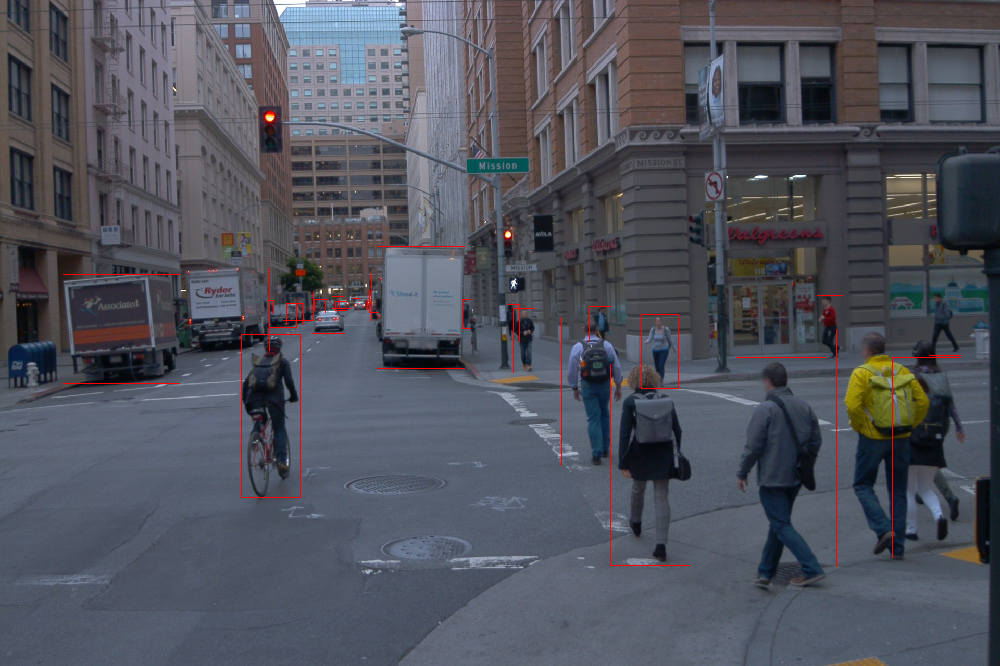

Objects in Image: ['Vehicle', 'Pedestrian', 'Sign']


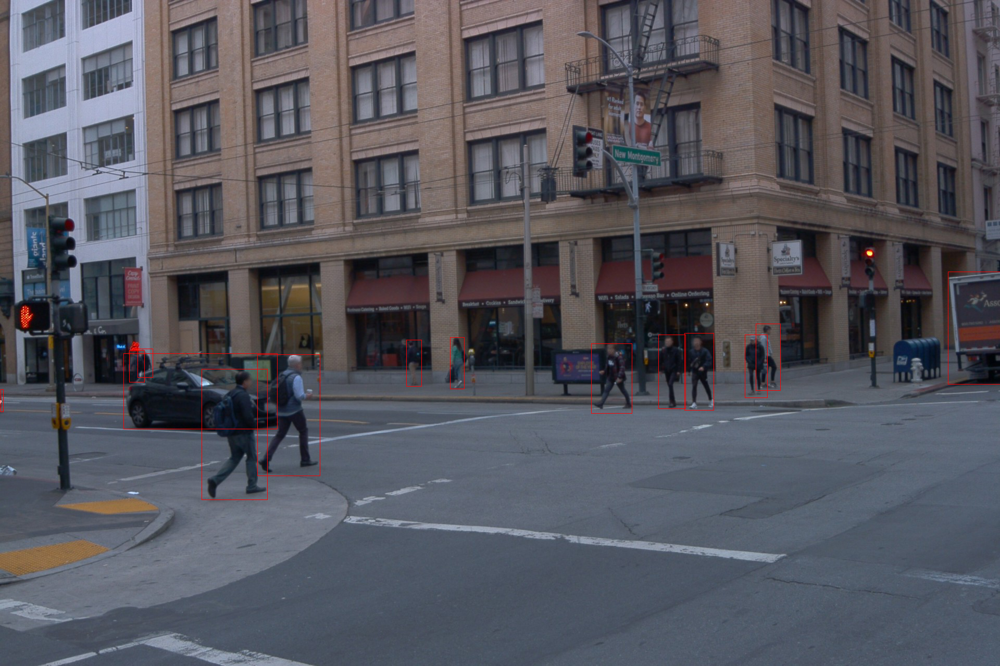

Objects in Image: ['Vehicle', 'Pedestrian', 'Sign']


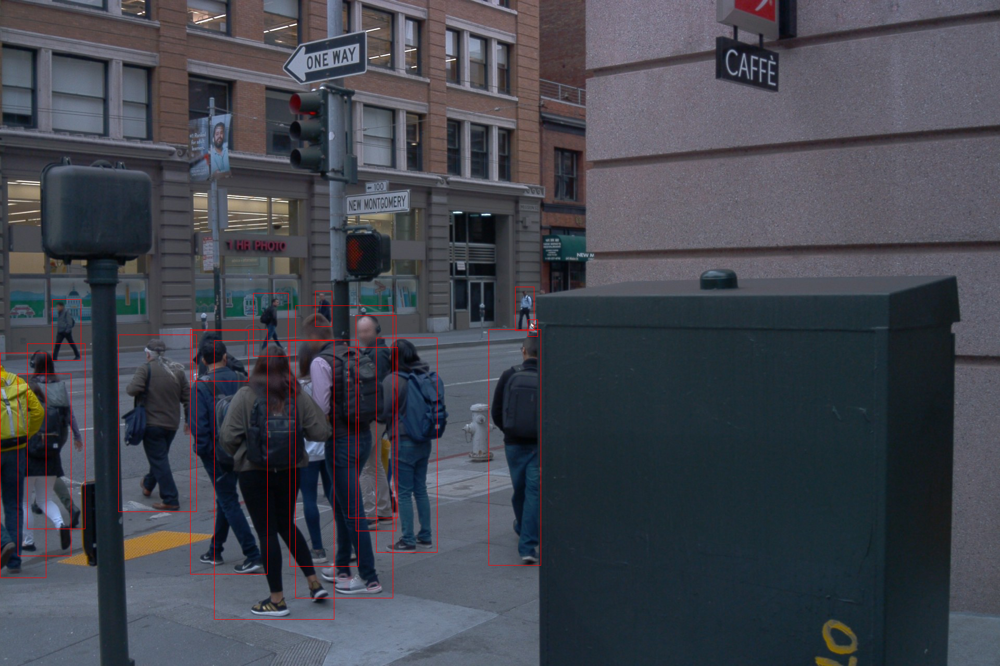

Objects in Image: ['Vehicle', 'Pedestrian', 'Sign']


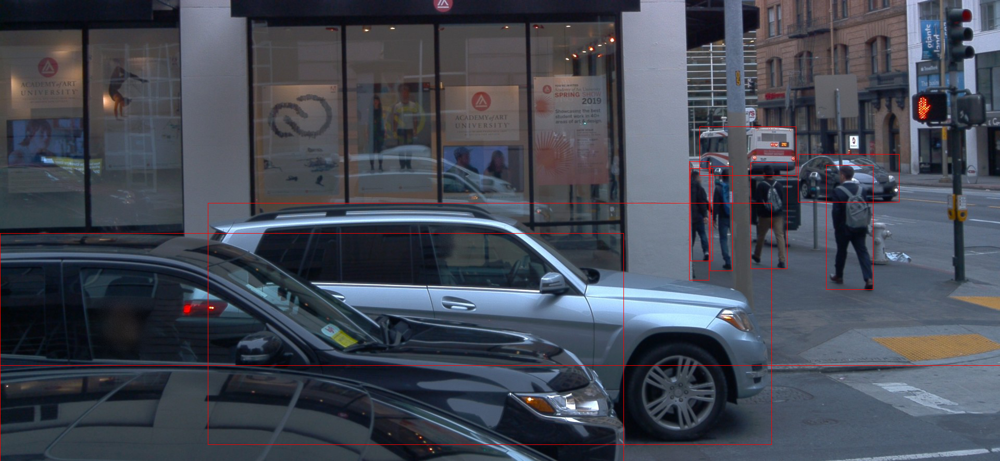

Objects in Image: ['Vehicle', 'Pedestrian', 'Sign']


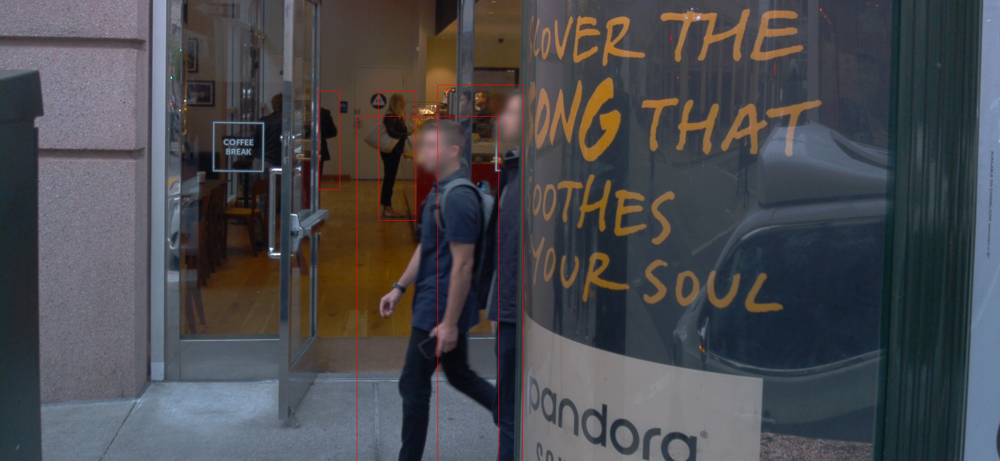

In [13]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Draw the bounding box on the image
    draw = ImageDraw.Draw(img)
    for _, row in df_box_frame.iterrows():
        x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
        y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
        x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
        y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
        if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
            draw.rectangle((x1, y1, x2, y2), outline='red')

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]

    # Object ID to label mapping
    object_mapping = {
        1: 'Vehicle',
        2: 'Pedestrian',
        3: 'Cyclist',
        4: 'Sign'
    }

    # Convert object IDs to labels using the mapping
    labels = [object_mapping[obj_id] for obj_id in object_ids]
    print("Objects in Image:", labels)

    # Show the image with bounding box
    img.show()

Vehicle: 28
Pedestrian: 51
Sign: 1


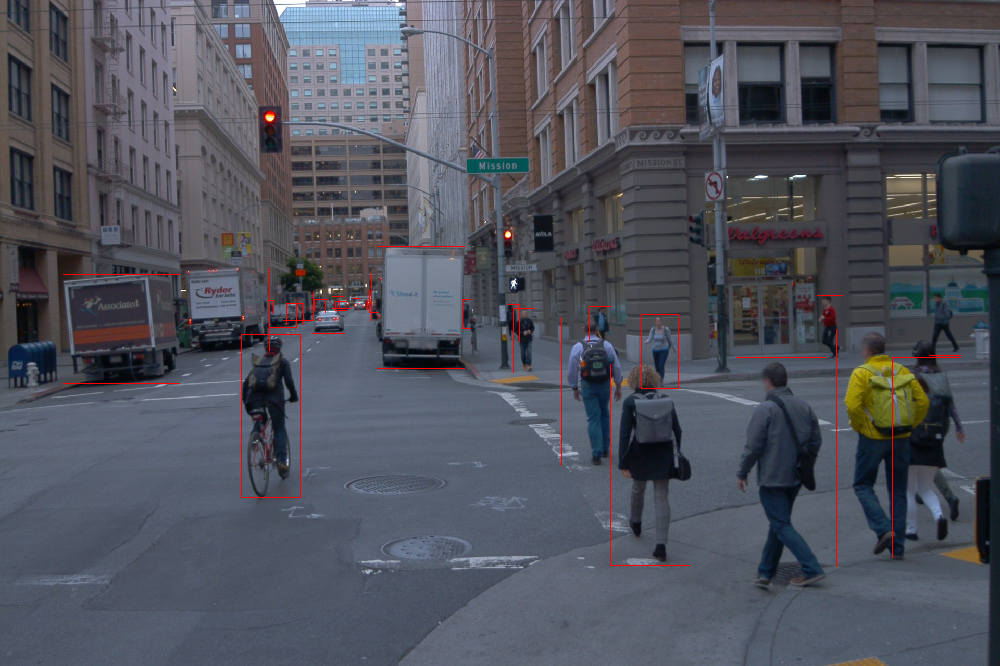

Vehicle: 28
Pedestrian: 51
Sign: 1


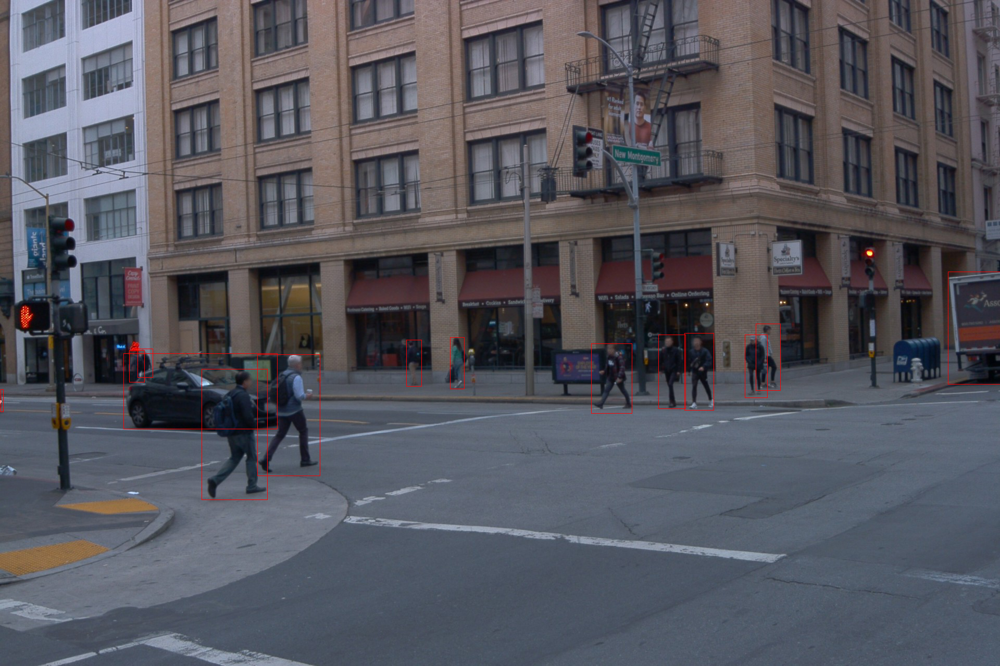

Vehicle: 28
Pedestrian: 51
Sign: 1


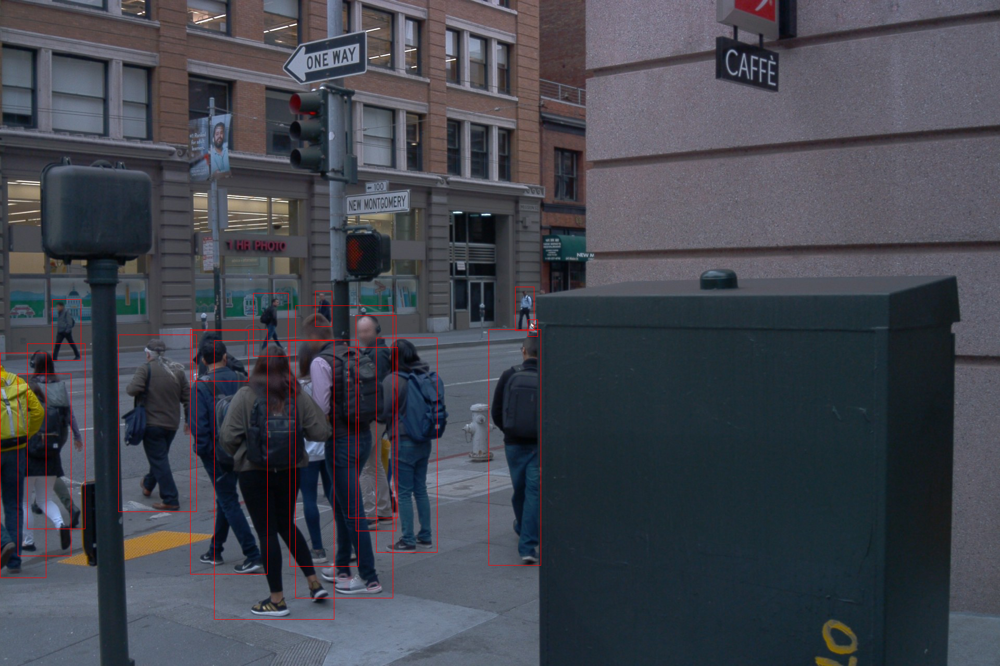

Vehicle: 28
Pedestrian: 51
Sign: 1


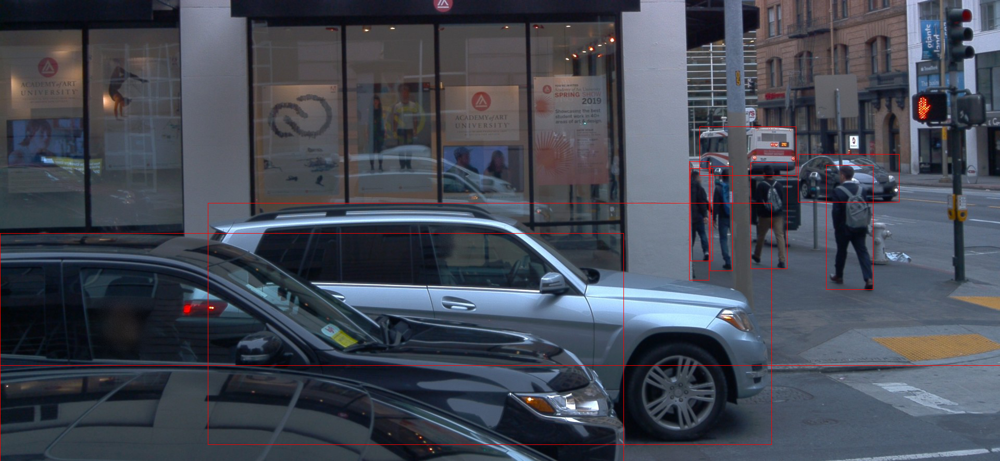

Vehicle: 28
Pedestrian: 51
Sign: 1


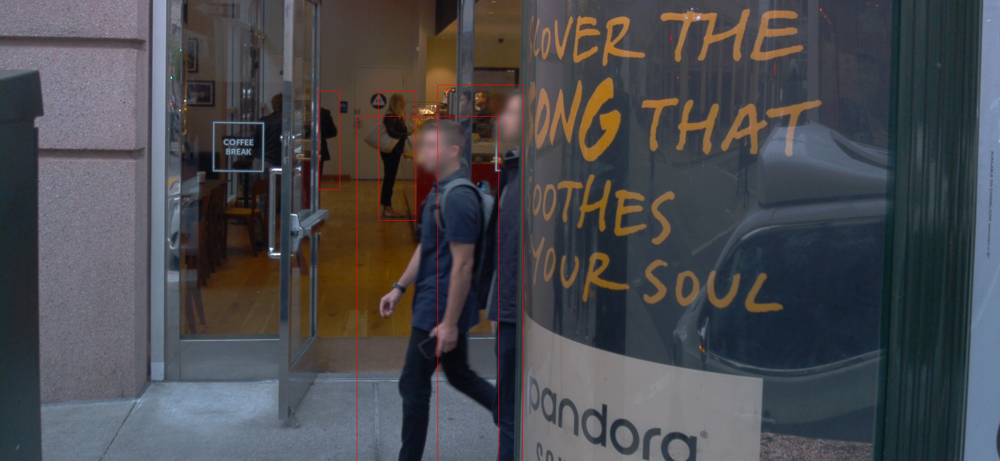

In [15]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Object ID to label mapping
    object_mapping = {
        1: 'Vehicle',
        2: 'Pedestrian',
        3: 'Cyclist',
        4: 'Sign'
    }

    # Iterate over the object IDs and counts
    for obj_id, count in zip(object_ids, object_counts):
        # Check if the object ID corresponds to vehicle, pedestrian, or sign
        if obj_id in [1, 2, 4]:
            label = object_mapping[obj_id]
            print(f"{label}: {count}")

    # Draw the bounding box on the image
    draw = ImageDraw.Draw(img)
    for _, row in df_box_frame.iterrows():
        x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
        y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
        x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
        y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
        if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
            draw.rectangle((x1, y1, x2, y2), outline='red')

    # Show the image with bounding box
    img.show()









Vehicle: 28
Pedestrian: 51
Sign: 1


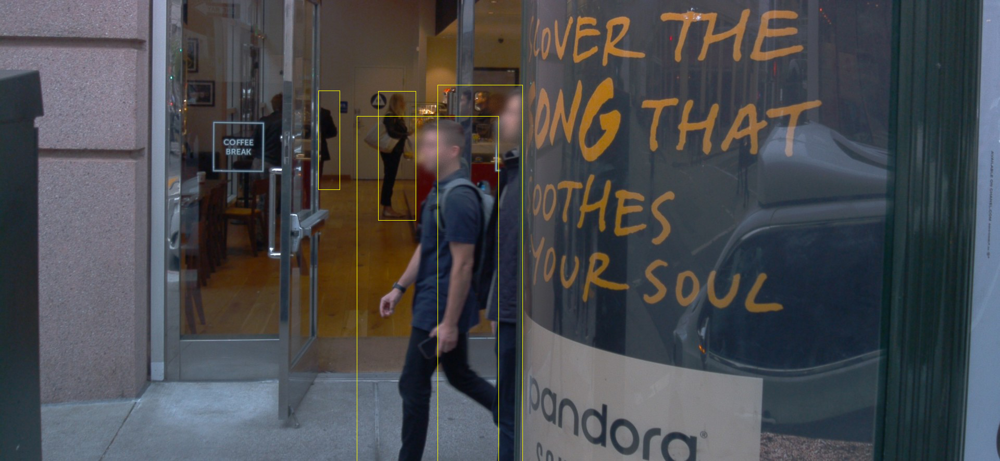

In [29]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Iterate over the object IDs and counts
for obj_id, count in zip(object_ids, object_counts):
    if obj_id in [1, 2, 3, 4]:
        label = object_mapping[obj_id]
        color = object_colors[label]
        print(f"{label}: {count}")

        # Draw the bounding box on the image with the assigned color
draw = ImageDraw.Draw(img)
for _, row in df_box_frame.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
    if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
        label = object_mapping[obj_id]
        color = object_colors[label]
        draw.rectangle((x1, y1, x2, y2), outline=color)
# Show the image with bounding boxes
img.show()

In [37]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Iterate over the camera names
images = []
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Draw the bounding boxes on the image
    draw = ImageDraw.Draw(img)
    for obj_id, count in zip(object_ids, object_counts):
        if obj_id in [1, 2, 3, 4]:
            label = object_mapping[obj_id]
            color = object_colors[label]
            print(f"{label}: {count}")

            # Find the rows in the camera box DataFrame that correspond to the current object ID
            df_obj_boxes = df_box_frame[df_box_frame['[CameraBoxComponent].box.object_id'] == obj_id]

            # Iterate over the object bounding boxes and draw them on the image with the assigned color
            for _, row in df_obj_boxes.iterrows():
                x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
                y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
                x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
                y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
                if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                    draw.rectangle((x1, y1, x2, y2), outline=color)

    images.append(img)  # Store the image in the list

# Show all the images with bounding boxes
for img in images:
    img.show()


Vehicle: 28


KeyError: ignored

In [38]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Iterate over the camera names
images = []
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Draw the bounding boxes on the image
    draw = ImageDraw.Draw(img)
    for obj_id, count in zip(object_ids, object_counts):
        if obj_id in [1, 2, 3, 4]:
            label = object_mapping[obj_id]
            color = object_colors[label]
            print(f"{label}: {count}")

            # Find the rows in the camera box DataFrame that correspond to the current object ID
            df_obj_boxes = df_box_frame[df_box_frame['[CameraBoxComponent].box.label'] == label]

            # Iterate over the object bounding boxes and draw them on the image with the assigned color
            for _, row in df_obj_boxes.iterrows():
                x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
                y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
                x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
                y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
                if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                    draw.rectangle((x1, y1, x2, y2), outline=color)

    images.append(img)  # Store the image in the list

# Show all the images with bounding boxes
for img in images:
    img.show()

Vehicle: 28


KeyError: ignored

Vehicle: 28
Pedestrian: 51
Sign: 1


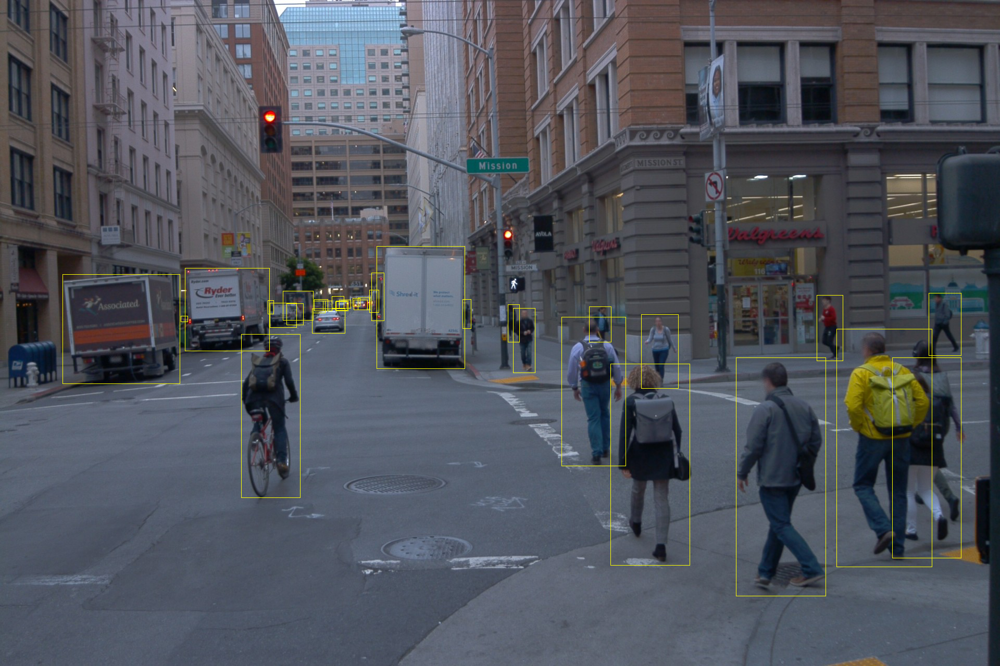

Vehicle: 28
Pedestrian: 51
Sign: 1


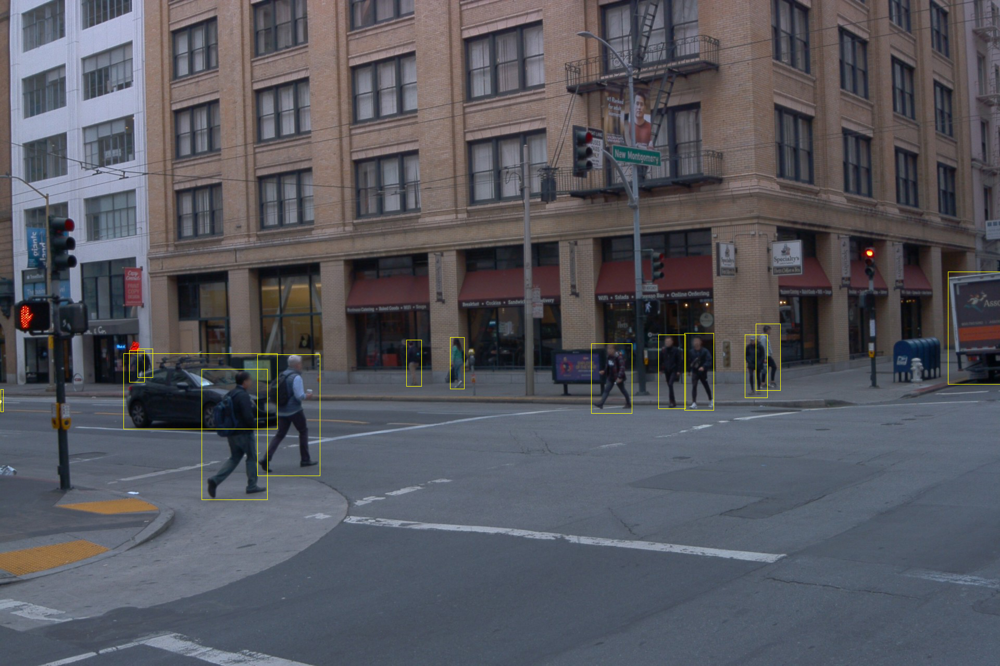

Vehicle: 28
Pedestrian: 51
Sign: 1


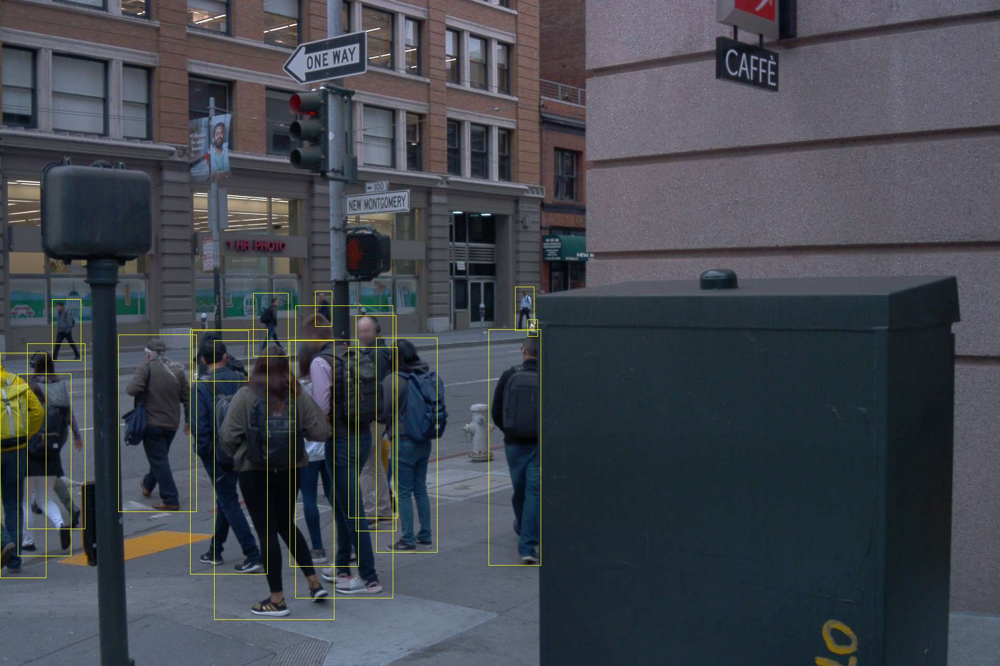

Vehicle: 28
Pedestrian: 51
Sign: 1


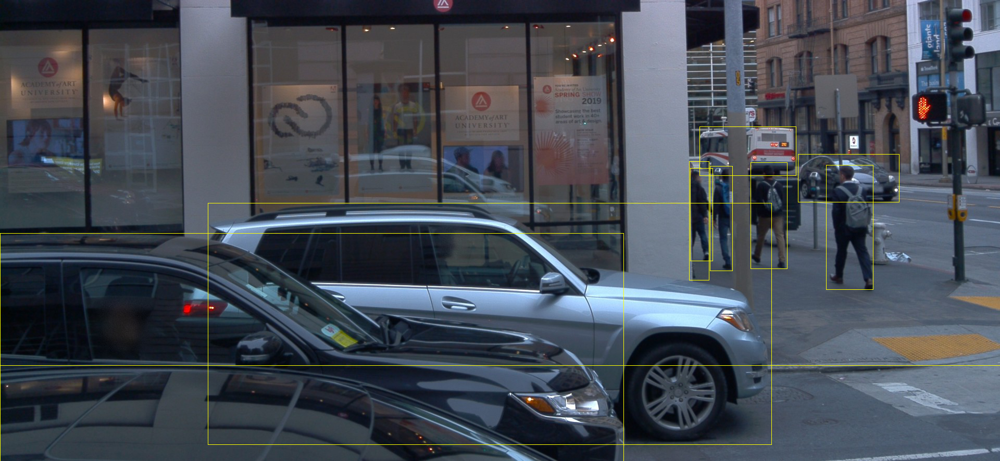

Vehicle: 28
Pedestrian: 51
Sign: 1


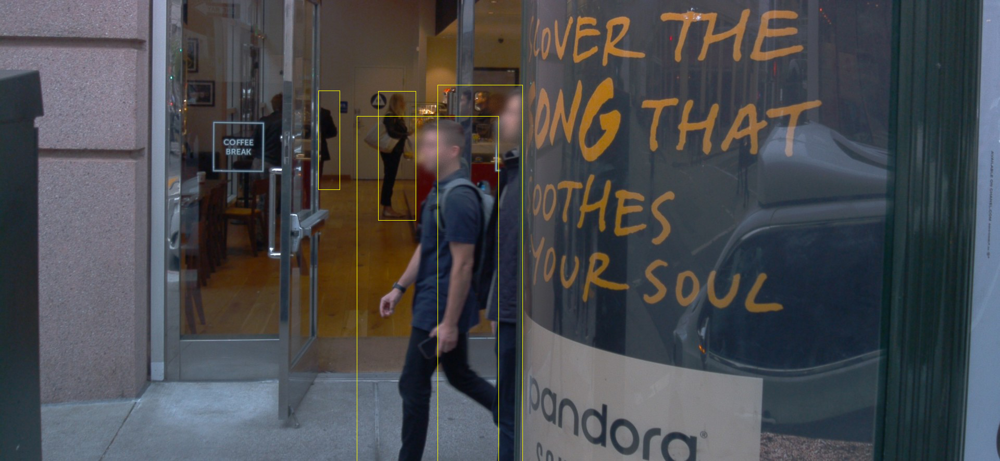

In [40]:
import numpy as np
from PIL import Image, ImageDraw
import pandas as pd
from io import BytesIO

# Load the camera box data from the first parquet file
df_box = pd.read_parquet('/content/drive/MyDrive/validation/camera_box/file1.parquet')

# Load the camera image data from the second parquet file
df_image = pd.read_parquet('/content/drive/MyDrive/validation/camera_image/file1.parquet')

# Load the statistics data from the third parquet file
df_stats = pd.read_parquet('/content/drive/MyDrive/validation/stats/file1.parquet')

# Set the desired frame timestamp
frame_timestamp = 1557845072664263

# Define the camera names
camera_names = [1, 2, 3, 4, 5]

# Object ID to label mapping
object_mapping = {
    1: 'Vehicle',
    2: 'Pedestrian',
    3: 'Cyclist',
    4: 'Sign'
}

# Define colors for each object class
object_colors = {
    'Vehicle': 'red',
    'Pedestrian': 'green',
    'Cyclist': 'blue',
    'Sign': 'yellow'
}

# Iterate over the camera names
for camera_name in camera_names:
    # Find the row in the camera box DataFrame that corresponds to the desired frame timestamp and camera name
    df_box_frame = df_box[(df_box['key.frame_timestamp_micros'] == frame_timestamp) & (df_box['key.camera_name'] == camera_name)]

    # Find the corresponding camera resolution
    width = int(df_box_frame['[CameraBoxComponent].box.size.x'].max())
    height = int(df_box_frame['[CameraBoxComponent].box.size.y'].max())

    # Find the row in the camera image DataFrame that corresponds to the desired frame timestamp, camera name
    df_image_frame = df_image[(df_image['key.frame_timestamp_micros'] == frame_timestamp) & (df_image['key.camera_name'] == camera_name)]

    # Read the camera image binary data into a stream
    img_stream = BytesIO(df_image_frame.iloc[0]['[CameraImageComponent].image'])

    # Open the image using PIL
    img = Image.open(img_stream)

    # Find the row in the statistics DataFrame that corresponds to the desired frame timestamp
    df_stats_frame = df_stats[df_stats['key.frame_timestamp_micros'] == frame_timestamp]

    # Extract the object IDs and counts from the statistics row
    object_ids = df_stats_frame['[StatsComponent].camera_object_counts.types'].values[0]
    object_counts = df_stats_frame['[StatsComponent].camera_object_counts.counts'].values[0]

    # Iterate over the object IDs and counts
    for obj_id, count in zip(object_ids, object_counts):
        # Check if the object ID corresponds to vehicle, pedestrian, cyclist, or sign
        if obj_id in [1, 2, 3, 4]:
            label = object_mapping[obj_id]
            color = object_colors[label]
            print(f"{label}: {count}")

            # Draw the bounding box on the image with the assigned color
            draw = ImageDraw.Draw(img)
            for _, row in df_box_frame.iterrows():
                x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
                y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
                x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
                y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)
                if not np.isnan(x1) and not np.isnan(y1) and not np.isnan(x2) and not np.isnan(y2):
                    draw.rectangle((x1, y1, x2, y2), outline=color)

    # Show the image with bounding boxes
    img.show()